In [1]:
import lime
import shap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from xgboost import XGBClassifier
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import FunctionTransformer

In [2]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 110)

In [3]:
data = r'C:\Users\DA1041TU\Documents\UpGrad\Data\Adults_Census_Dataset\adult.data'

In [4]:
def data_import(data=data):
    
    col_names = ['age', 'workclass', 'fnlwgt', 'education', 'education_num', 'marital-status', 'occupation', 'relationship',
            'race', 'sex', 'capital_gain', 'capital_loss', 'hours_per_week', 'native_country', 'inc_>50K']
    
    df = pd.read_csv(data, names=col_names)
    
    return df

In [5]:
census = data_import(data=data)

In [6]:
def split(data=census):
#     from sklearn.model_selection import train_test_split
    X = census.drop('inc_>50K', axis=1)
    y = census['inc_>50K']
    
    X_train, X_test, y_train, y_test = train_test_split(X,y,random_state=42)
    
    return X_train.copy(), X_test.copy(), y_train.copy(), y_test.copy()

In [7]:
X_train, X_test, y_train, y_test = split(data=census)

In [8]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((24420, 14), (8141, 14), (24420,), (8141,))

In [9]:
y_train = y_train.apply(lambda x: 1 if x==' >50K' else 0)

In [10]:
def data_clean(data=X_train):
    data.loc[data['workclass']==' ?', 'workclass'] = data['workclass'].mode()
    data.loc[data['occupation']==' ?', 'occupation'] = data['occupation'].mode()
    data.loc[data['native_country']==' ?', 'native_country'] = data['native_country'].mode()
    
    return data.copy()

In [11]:
# X_train, = data_clean(data=X_train, target=y_train)

In [12]:
cat_cols = []
for i in X_train.columns:
    if X_train[i].dtypes == 'object':
        cat_cols.append(i)

In [13]:
ft_clean = FunctionTransformer(data_clean)

In [14]:
ct = ColumnTransformer(transformers=[('ohe',OneHotEncoder(sparse=False,handle_unknown='ignore'),cat_cols)],
                       remainder='passthrough')

In [15]:
pipe = Pipeline(steps=[('data_clean', ft_clean), ('ohe',ct)])

In [16]:
df_train = pd.DataFrame(pipe.fit_transform(X_train))

In [17]:
col_names = list(pipe.named_steps.ohe.named_transformers_.ohe.get_feature_names_out())+\
['age','fnlwgt','education_num','capital_gain', 'capital_loss', 'hours_per_week']

In [18]:
df_train.columns = col_names

In [19]:
df_train.head()

,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Never-worked,workclass_ Private,workclass_ Self-emp-inc,workclass_ Self-emp-not-inc,workclass_ State-gov,workclass_ Without-pay,workclass_nan,education_ 10th,education_ 11th,education_ 12th,education_ 1st-4th,education_ 5th-6th,education_ 7th-8th,education_ 9th,education_ Assoc-acdm,education_ Assoc-voc,education_ Bachelors,education_ Doctorate,education_ HS-grad,education_ Masters,education_ Preschool,education_ Prof-school,education_ Some-college,marital-status_ Divorced,marital-status_ Married-AF-spouse,marital-status_ Married-civ-spouse,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,occupation_ Adm-clerical,occupation_ Armed-Forces,occupation_ Craft-repair,occupation_ Exec-managerial,occupation_ Farming-fishing,occupation_ Handlers-cleaners,occupation_ Machine-op-inspct,occupation_ Other-service,occupation_ Priv-house-serv,occupation_ Prof-specialty,occupation_ Protective-serv,occupation_ Sales,occupation_ Tech-support,occupation_ Transport-moving,occupation_nan,relationship_ Husband,relationship_ Not-in-family,relationship_ Other-relative,...,sex_ Female,sex_ Male,native_country_ Cambodia,native_country_ Canada,native_country_ China,native_country_ Columbia,native_country_ Cuba,native_country_ Dominican-Republic,native_country_ Ecuador,native_country_ El-Salvador,native_country_ England,native_country_ France,native_country_ Germany,native_country_ Greece,native_country_ Guatemala,native_country_ Haiti,native_country_ Holand-Netherlands,native_country_ Honduras,native_country_ Hong,native_country_ Hungary,native_country_ India,native_country_ Iran,native_country_ Ireland,native_country_ Italy,native_country_ Jamaica,native_country_ Japan,native_country_ Laos,native_country_ Mexico,native_country_ Nicaragua,native_country_ Outlying-US(Guam-USVI-etc),native_country_ Peru,native_country_ Philippines,native_country_ Poland,native_country_ Portugal,native_country_ Puerto-Rico,native_country_ Scotland,native_country_ South,native_country_ Taiwan,native_country_ Thailand,native_country_ Trinadad&Tobago,native_country_ United-States,native_country_ Vietnam,native_country_ Yugoslavia,native_country_nan,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,49.0,193366.0,9.0,0.0,0.0,40.0
1,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,27.0,134152.0,9.0,0.0,0.0,45.0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,44.0,169980.0,7.0,0.0,0.0,60.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,59.0,656036.0,13.0,0.0,0.0,60.0
4,0.0,0.0,0.0,1.0,

# 1. Random Forest Classifier

In [20]:
rf = RandomForestClassifier(n_estimators=700, max_depth=10, min_samples_split=100,
                            min_samples_leaf=5, random_state=42, class_weight='balanced',
                            max_features=10, max_samples=19000, ccp_alpha=0)

In [21]:
rf.fit(df_train, y_train)

RandomForestClassifier(ccp_alpha=0, class_weight='balanced', max_depth=10,
                       max_features=10, max_samples=19000, min_samples_leaf=5,
                       min_samples_split=100, n_estimators=700,
                       random_state=42)

In [22]:
shap_rf_explainer = shap.TreeExplainer(rf)

In [23]:
# %%time
# # Wall time: 40min 36s
# shap_rf_values_train = shap_rf_explainer.shap_values(df_train)

Wall time: 40min 36s


In [25]:
# import joblib
# joblib.dump(shap_rf_values_train, 'shap_rf_values_train')

In [26]:
import joblib
shap_rf_values_train = joblib.load('shap_rf_values_train')

In [24]:
# First dimension is number of classes, in this case 2 as this is binary classification
# [0] - is for class 0 (<=50K) and 
# [1] - is for class 1(>50K)
np.shape(shap_rf_values_train)

(2, 24420, 108)

In [62]:
rf_imp = pd.DataFrame(rf.feature_importances_,df_train.columns).sort_values(by=0, ascending=False).head(10)
rf_imp

,0
marital-status_ Married-civ-spouse,0.184040
relationship_ Husband,0.104307
education_num,0.092039
marital-status_ Never-married,0.089166
capital_gain,0.083345
age,0.080959
hours_per_week,0.041586
relationship_ Own-child,0.038131
relationship_ Not-in-family,0.026547
relationship_ Wife,0.023414


# SHAP

- SHAP (**SH**apley **A**dditive ex**P**lanations) based on game theory:
    - Is Additive:
        - Adds all the shap values of the features to obtain final shap value for every data point
    - Is Consistent:
        - Even if we perturb the value of data point slightly the predictions won't change
- Model agnostic as well as model specific explainers
- Interpretation scope:
    - Global:
        - summary plot
    - Local:
        - dependency plot
        - force plot (single data point)
        - force plot (all data point)
- Model specific explainers like (to name a few):
    - shap.TreeExplainer
    - shap.LinearExplainer
    - shap.GradientExplainer
    - shap.DeepExplainer
    - shap.PermutationExplainer
- Model agnostic explainer:
    - KernelExplainer:
        - Time consuming
        - We can use K-Means option to select subset of the dataset and use it to obtain shap values
        - We get only approximations and not exact shap values
- It is slow and some times very time consuming especially 'KernelExplainer'

### SHAP summary plot

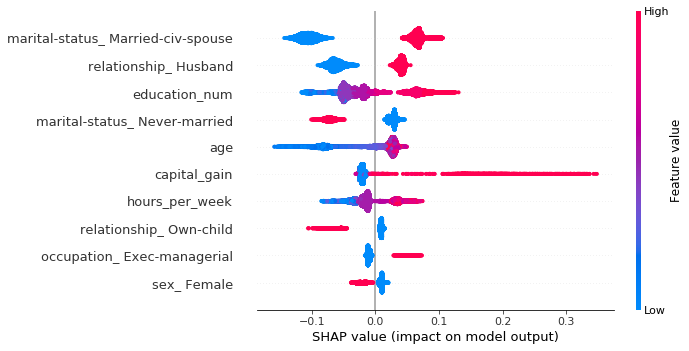

In [54]:
# This plot displays top 20 features, we can change it by setting parameter 'max_display=' to any number
shap.summary_plot(shap_rf_values_train[1], df_train, max_display=10)# plot_type='dot', 

**Observations:**<br>
    - The above plot is very intuitive<br>
    - The 'marital-status_Married-civ-spouse' is the most important feature according to shap<br>
    - More the probability of marital-status to be Married-civ-spouse more is the chances of income being '>50K'<br>
    - More the probability of relationship to be husband more is the chances of income being '>50K', that means if relationship is wife then chances are that income will be '<=50K'<br>
    - Higher the value of 'education_num', 'age', 'capital_gain', 'hours_per_week' and 'occupation_Exec-managerial' higher the chances of having income '>50K'
    - Out of Top 10 features top 8 features of 'Random Forest' and SHAP are same, barring last 2

In [60]:
df_train['marital-status_ Never-married'].head()

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: marital-status_ Never-married, dtype: float64

In [61]:
top_features = ['marital-status_ Married-civ-spouse'] + ['relationship_ Husband'] + ['education_num'] + \
               ['marital-status_ Never-married'] + ['age'] + ['capital_gain'] + ['hours_per_week']

top_df = df_train.loc[df_train.index,top_features]

### Heatmap

In [63]:
from scipy.stats import spearmanr
import seaborn as sn

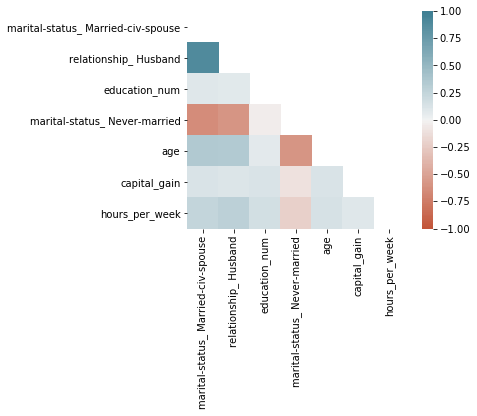

In [65]:
corrs = spearmanr(top_df).correlation
mask = np.zeros_like(corrs)
mask[np.triu_indices_from(mask)] = True
ax = sn.heatmap(corrs, vmin=-1, vmax=1, center=0, mask=mask,
                square=True, cmap=sn.diverging_palette(20,220,n=200),
                xticklabels=top_df.columns, yticklabels=top_df.columns)

### SHAP dependence plot

In [19]:
y_test = y_test.apply(lambda x: 1 if x==' >50K' else 0)

In [20]:
df_test = pd.DataFrame(pipe.transform(X_test))

In [21]:
df_test.columns = col_names

In [48]:
df_test.head()

,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Never-worked,workclass_ Private,workclass_ Self-emp-inc,workclass_ Self-emp-not-inc,workclass_ State-gov,workclass_ Without-pay,workclass_nan,education_ 10th,education_ 11th,education_ 12th,education_ 1st-4th,education_ 5th-6th,education_ 7th-8th,education_ 9th,education_ Assoc-acdm,education_ Assoc-voc,education_ Bachelors,education_ Doctorate,education_ HS-grad,education_ Masters,education_ Preschool,education_ Prof-school,education_ Some-college,marital-status_ Divorced,marital-status_ Married-AF-spouse,marital-status_ Married-civ-spouse,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,occupation_ Adm-clerical,occupation_ Armed-Forces,occupation_ Craft-repair,occupation_ Exec-managerial,occupation_ Farming-fishing,occupation_ Handlers-cleaners,occupation_ Machine-op-inspct,occupation_ Other-service,occupation_ Priv-house-serv,occupation_ Prof-specialty,occupation_ Protective-serv,occupation_ Sales,occupation_ Tech-support,occupation_ Transport-moving,occupation_nan,relationship_ Husband,relationship_ Not-in-family,relationship_ Other-relative,...,sex_ Female,sex_ Male,native_country_ Cambodia,native_country_ Canada,native_country_ China,native_country_ Columbia,native_country_ Cuba,native_country_ Dominican-Republic,native_country_ Ecuador,native_country_ El-Salvador,native_country_ England,native_country_ France,native_country_ Germany,native_country_ Greece,native_country_ Guatemala,native_country_ Haiti,native_country_ Holand-Netherlands,native_country_ Honduras,native_country_ Hong,native_country_ Hungary,native_country_ India,native_country_ Iran,native_country_ Ireland,native_country_ Italy,native_country_ Jamaica,native_country_ Japan,native_country_ Laos,native_country_ Mexico,native_country_ Nicaragua,native_country_ Outlying-US(Guam-USVI-etc),native_country_ Peru,native_country_ Philippines,native_country_ Poland,native_country_ Portugal,native_country_ Puerto-Rico,native_country_ Scotland,native_country_ South,native_country_ Taiwan,native_country_ Thailand,native_country_ Trinadad&Tobago,native_country_ United-States,native_country_ Vietnam,native_country_ Yugoslavia,native_country_nan,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,27.0,160178.0,10.0,0.0,0.0,38.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,45.0,50567.0,9.0,0.0,0.0,40.0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,29.0,185908.0,13.0,0.0,0.0,55.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,30.0,190040.0,13.0,0.0,0.0,40.0
4,0.0,0.0,0.0,0.0

In [31]:
# %%time
# # Wall time: 10min 58s
# shap_rf_values_test = shap_rf_explainer.shap_values(df_test)

Wall time: 10min 58s


In [32]:
# joblib.dump(shap_rf_values_test, 'shap_rf_values_test')

['shap_rf_values_test']

In [27]:
shap_rf_values_test = joblib.load('shap_rf_values_test')

Plot number 1: marital-status_ Married-civ-spouse vs. relationship_ Husband


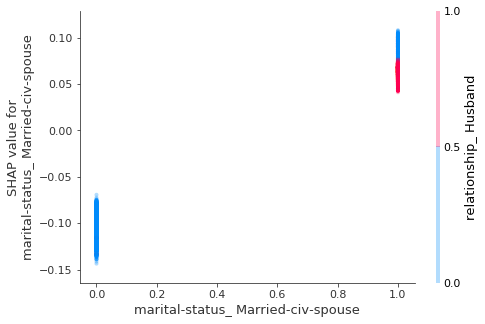

spearman->marital-status_ Married-civ-spouse: 0.894-val: 0.0000

***************************************************************************
Plot number 2: relationship_ Husband vs. marital-status_ Never-married


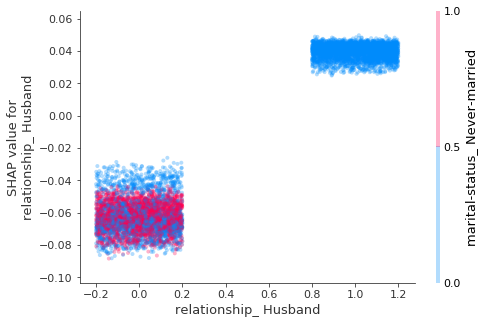

spearman->relationship_ Husband: -0.579-val: 0.0000


In [72]:
print('Plot number 1: marital-status_ Married-civ-spouse vs. relationship_ Husband')
shap.dependence_plot('marital-status_ Married-civ-spouse',
                     shap_rf_values_test[1],df_test,
                     interaction_index='relationship_ Husband',
                     alpha=0.3)

print('spearman->marital-status_ Married-civ-spouse: %.3f-val: %.4f' % 
     (spearmanr(df_train['relationship_ Husband'].values,
               df_train['marital-status_ Married-civ-spouse'].values)),end='\n\n')

print('*'*75)

print('Plot number 2: relationship_ Husband vs. marital-status_ Never-married')
shap.dependence_plot('relationship_ Husband',
                     shap_rf_values_test[1],df_test,
                     interaction_index='marital-status_ Never-married',
                     alpha=0.3, x_jitter=0.4)

print('spearman->relationship_ Husband: %.3f-val: %.4f' % 
     (spearmanr(df_train['marital-status_ Never-married'].values,
               df_train['relationship_ Husband'].values)))

**Plot number 1: marital-status_ Married-civ-spouse vs. relationship_ Husband:**<br>
        - As probability of marital-status_ Married-civ-spouse increase, the probability of relationship_ Husband also increase and vice-versa<br>
        - Spearman correlation is 0.89 and p-val is around 0 which is significant

**Plot number 2: relationship_ Husband vs. marital-status_ Never-married:**<br>
        - if the probability of relationship_ Husband is low, the possibility of marital-status_ Never-married is high and vice-versa, quite intuitive<br>
        - Spearman correlation is 0.57 and p-val is around 0 which is significant

Plot number 1: capital_gain vs. education_num


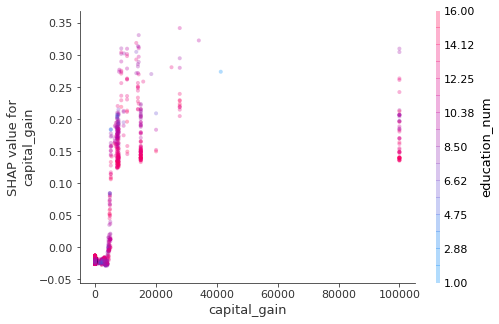

spearman->capital_gain: 0.122-val: 0.0000

***************************************************************************
Plot number 2: age vs. capital_gain


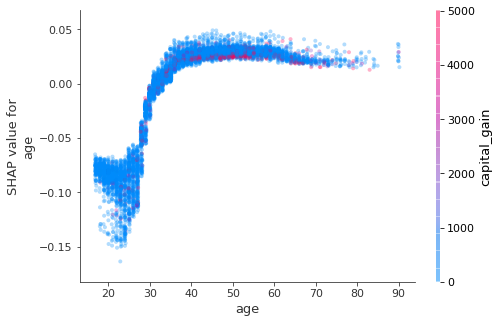

spearman->age: 0.124-val: 0.0000


In [77]:
print('Plot number 1: capital_gain vs. education_num')
shap.dependence_plot('capital_gain',
                     shap_rf_values_test[1],df_test,
                     interaction_index='education_num',
                     alpha=0.3)

print('spearman->capital_gain: %.3f-val: %.4f' % 
     (spearmanr(df_train['education_num'].values,
               df_train['capital_gain'].values)),end='\n\n')

print('*'*75)

print('Plot number 2: age vs. capital_gain')
shap.dependence_plot('age',
                     shap_rf_values_test[1],df_test,
                     interaction_index='capital_gain',
                     alpha=0.3, x_jitter=0.4)

print('spearman->age: %.3f-val: %.4f' % 
     (spearmanr(df_train['capital_gain'].values,
               df_train['age'].values)))

**Plot number 1: capital_gain vs. education_num:**<br>
        - As education_num increases the cap gains also increases<br>
        - High cap gain also has high education_num, most of people even with high education have cap gain <=40K, with very few people having cap gain around 100K<br>
        - Spearman correlation is 0.122 and p-val is around 0 which is significant 

**Plot number 2: age vs. capital_gain:**<br>
        - As age increases the capital gain also increases sharply till age 40 (amount of cap gain is not that much but there are also some data points having high cap gains), after that it flattens<br>
        - Even at young age some people have high cap gains, may be because of family own business or start-ups<br>
        - Spearman correlation is 0.124 and p-val is around 0 which is significant

''

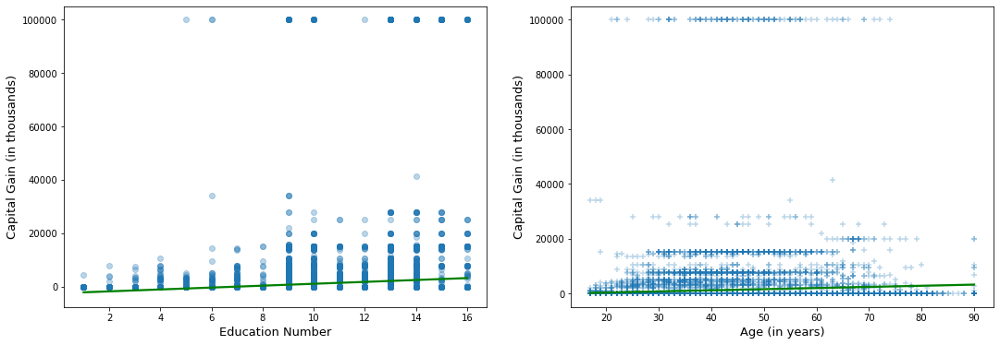

In [81]:
fig, ax = plt.subplots(1,2,figsize=(18,6))
sn.regplot(x=df_train['education_num'], y=df_train['capital_gain'],
          ax=ax[0], scatter_kws={'alpha':0.3}, line_kws={'color':'g'})
ax[0].set_ylabel('Capital Gain (in thousands)', fontsize=13)
ax[0].set_xlabel('Education Number', fontsize=13)

sn.regplot(x=df_train['age'], y=df_train['capital_gain'],
          ax=ax[1], marker='+',
           scatter_kws={'alpha':0.3}, line_kws={'color':'g'})
ax[1].set_ylabel('Capital Gain (in thousands)', fontsize=13)
ax[1].set_xlabel('Age (in years)', fontsize=13)
;

**Observation:**<br>
    - Regplot justifies above observations

### SHAP force plots

In [28]:
from scipy import math

In [41]:
# shap_rf_explainer.expected_value[1]

0.5000078961650612

#### Force plot 1

In [29]:
# sample_size = 0.05
# sample_test_idx = np.random.choice(a=X_test.shape[0],
#                                    size=math.ceil(X_test.shape[0]*sample_size),
#                                    replace=False)

# shap.initjs()
# shap.force_plot(shap_rf_explainer.expected_value[1],
#                 shap_rf_values_test[1][sample_test_idx],
#                 X_test.iloc[sample_test_idx])
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**<br>
    - **Note:** The sample set is selected randomly, for this set of sample the observation is as follows<br>
    - Except for 'race_ Amer-Indian-Eskimo' other categories of race such as 'race_ White', 'race_ Black', 'race_ Other' etc the mean effects that they have on capital_gain is lower<br>
    - For 'race_ Amer-Indian-Eskimo' the mean effects on capital_gain is higher

In [89]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**<br>
    - **Note:** The sample set is selected randomly, for this set of sample the observation is as follows<br>
    - The mean effect on capital_gain tend to be lower for ages below 20 yrs and above 65 yrs<br>
    - The mean effect on capital_gain tend to be higher for age intervals (50-55 yrs) and (63-65 yrs) and for the rest of the intervals the mean effect fluctuates

In [30]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**<br>
    - **Note:** The sample set is selected randomly, for this set of sample the observation is as follows<br>
    - Here we can see the shap values for various ages, 'age effects' i.e shap values for age vs. 'age'<br>
    - Possibility of having income '>50K' is lower for ages below 32 yrs, after 32 yrs the possibility increases

In [49]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows
- Here we can see the shap values for various education_num, 'education_num effects' i.e shap values for education_num vs. 'education_num'
- As per random forest model possibility of having income '>50K' is lower for education_num below 12, after that the possibility increases and it is highest at education_num==15

#### Force plot 2

In [97]:
# Actual value: 0, Predicted value: 0
shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][0],
                df_test.iloc[0])

**Observation:**<br>
- Actual value: 0, Predicted value: 0
- The output probability of 0.08 is prediction for this observation
- The base value is 0.5 as this is classification and by default the threshold is 0.5 i.e. anything above 0.5 is predicted as '1' and anything less than equal to 0.5 is predicted as '0'
- The features that push prediction **towards '0'** are shown **in 'Red'** and the features that push prediction **away from '0'** are shown **in 'Blue'**
- The value of 'marital-status_ Never-married' is 0 and this influences the model to predict the observation value as '0'
- For this observation model considers only the value of 'marital-status_ Never-married' to predict the value as '0'
- The values of features in blue have negative impact

In [100]:
# Actual value: 1, Predicted value: 1
shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][5],
                df_test.iloc[5])

**Observation:**<br>
- Actual value: 1, Predicted value: 1
- The output probability of 0.87 is prediction for this observation
- The base value is 0.5 as this is classification and by default the threshold is 0.5 i.e. anything above 0.5 is predicted as '1' and anything less than equal to 0.5 is predicted as '0'
- The features that push prediction higher **towards '1'** are shown **in 'Red'** and the features that push prediction lower **away from '1'** are shown **in 'Blue'**
- The value of 'education_ Masters'==1, 'relationship_ Husband'==1, 'occupation_ Prof-speciality'==1, 'marital-status_ Married-civ-spouse'==1 and 'education_num'==14 influences the model to predict the observation value as '1' and they have positive impact
- The feature 'capital_gain'==0 is in blue and has negative impact

In [120]:
# Actual value: 0, Predicted value: 1
shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][1],
                df_test.iloc[1])

**Observation:**<br>
- Actual value: 0, Predicted value: 1
- The output probability of 0.66 is prediction for this observation
- The base value is 0.5 as this is classification and by default the threshold is 0.5 i.e. anything above 0.5 is predicted as '1' and anything less than equal to 0.5 is predicted as '0'
- The features that push prediction higher **towards '1'** are shown **in 'Red'** and the features that push prediction lower **away from '1'** are shown **in 'Blue'**
- The value of 'marital-status_ Never-married'==0, 'relationship_ Wife'==1, 'occupation_ Exec-managerial'==1 and 'marital-status_ Married-civ-spouse'==1 influences the model to predict the observation value as '1' and model considers them to have positive impact
- The model considers the features in blue to have negative impact

In [116]:
# Actual value: 1, Predicted value: 0
shap.initjs()
shap.force_plot(shap_rf_explainer.expected_value[1],
                shap_rf_values_test[1][12],
                df_test.iloc[12])

**Observation:**<br>
- Actual value: 1, Predicted value: 0
- The output probability of 0.36 is prediction for this observation
- The base value is 0.5 as this is classification and by default the threshold is 0.5 i.e. anything above 0.5 is predicted as '1' and anything less than equal to 0.5 is predicted as '0'
- The features that push prediction higher **towards '0'** are shown **in 'Red'** and the features that push prediction lower **away from '0'** are shown **in 'Blue'**
- The value of 'age'==41, occupation_ Prof-speciality'==1 and 'education_num'==13 wrongly influences the model to predict the observation value as '1' and model considers them to have positive impact
- The model wrongly considers the features in blue such as 'marital-status_ Married-civ-spouse'==0, 'relationship_ Husband'==0, 'marital-status_ Never-married'==1 to have negative impact

**Overall Observation:**
- As 'hours_per_week' increases the chances of income being '>50K' also increases
- 'education_num' of greater than equal to 12 increases the chances of income being '>50K'
- 'age' of greater than equal to 32 increases the chances of income being '>50K'
- Also, 'sex'=='male' increases the chances of income being '>50K'
- 'capital_gain'==0 lowers the chances of income being '>50K'
- 'capital_gain' of greater than equal to 4700 increases the chances of income being '>50K'

# 2. XGBoost Classifier

In [23]:
xgb = XGBClassifier(n_estimators=500, max_depth=10, random_state=42, learning_rate=0.05,
                    gamma=0.1, eval_metric='logloss', use_label_encoder=False,
                    min_child_weight=0.1, reg_lambda=1, reg_alpha=20,
                    max_delta_step=10, scale_pos_weight=3.1291849847818733)

In [24]:
# df_train = df_train.astype('int')

In [25]:
xgb.fit(df_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              eval_metric='logloss', gamma=0.1, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.05, max_delta_step=10,
              max_depth=10, min_child_weight=0.1, missing=nan,
              monotone_constraints='()', n_estimators=500, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=42,
              reg_alpha=20, reg_lambda=1, scale_pos_weight=3.1291849847818733,
              subsample=1, tree_method='exact', use_label_encoder=False,
              validate_parameters=1, verbosity=None)

In [26]:
xgb_imp = pd.DataFrame(xgb.feature_importances_, df_train.columns).sort_values(by=0, ascending=False).nlargest(10,columns=0)

In [79]:
comb_imp = pd.concat([rf_imp.reset_index().rename(columns={'index':'RF_Features',0:'Importance'}),
           xgb_imp.reset_index().rename(columns={'index':'XGB_Features',0:'Importance'})], axis=1)
comb_imp

,RF_Features,Importance,XGB_Features,Importance
0,marital-status_ Married-civ-spouse,0.184040,marital-status_ Married-civ-spouse,0.666349
1,relationship_ Husband,0.104307,education_num,0.036804
2,education_num,0.092039,capital_gain,0.032012
3,marital-status_ Never-married,0.089166,relationship_ Own-child,0.015595
4,capital_gain,0.083345,capital_loss,0.010033
5,age,0.080959,age,0.008376
6,hours_per_week,0.041586,occupation_ Exec-managerial,0.007549
7,relationship_ Own-child,0.038131,hours_per_week,0.007281
8,relationship_ Not-in-family,0.026547,sex_ Female,0.007020
9,relationship_ Wife,0.023414,occupation_ Other-service,0.006288


In [27]:
shap_xgb_explainer = shap.TreeExplainer(xgb)

In [28]:
%%time
# Wall time: 1min 1s
shap_xgb_values_train = shap_xgb_explainer.shap_values(df_train)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


Wall time: 53.3 s


In [25]:
# import joblib
# joblib.dump(shap_xgb_values_train, 'shap_xgb_values_train')

In [26]:
# # import joblib
# shap_xgb_values_train = joblib.load('shap_xgb_values_train')

In [28]:
xgb_imp

,0
marital-status_ Married-civ-spouse,0.666349
education_num,0.036804
capital_gain,0.032012
relationship_ Own-child,0.015595
capital_loss,0.010033
age,0.008376
occupation_ Exec-managerial,0.007549
hours_per_week,0.007281
sex_ Female,0.007020
occupation_ Other-service,0.006288


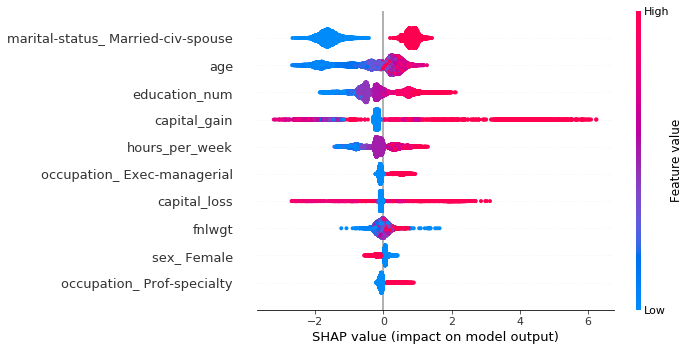

In [34]:
# This plot displays top 20 features, we can change it by setting parameter 'max_display=' to any number
shap.summary_plot(shap_xgb_values_train, df_train, max_display=10)# plot_type='dot', 

**Observations:**<br>
    - The above plot is very intuitive<br>
    - The 'marital-status_Married-civ-spouse' is the most important feature according to shap<br>
    - More the probability of marital-status to be Married-civ-spouse more is the chances of income being '>50K'<br>
    - More is the age of an individual more is the chances of income being '>50K'<br>
    - Higher the value of 'education_num', 'age', 'capital_gain', 'hours_per_week' and 'occupation_Exec-managerial' higher the chances of having income '>50K'
    - Out of Top 10 features top 8 features of 'XG Boost' and SHAP are same, barring 'fnlwgt' and 'occupation_ Prof-speciality'

In [29]:
top_features = ['marital-status_ Married-civ-spouse'] + ['occupation_ Exec-managerial'] + ['education_num'] + \
               ['occupation_ Prof-specialty'] + ['age'] + ['capital_gain'] + ['hours_per_week']

top_df = df_train.loc[df_train.index,top_features]

### Heatmap

In [30]:
from scipy.stats import spearmanr
import seaborn as sb

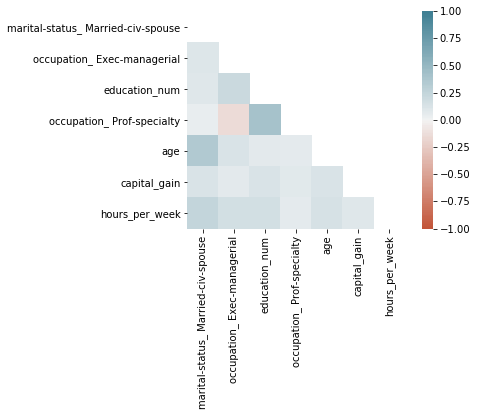

In [39]:
corrs = spearmanr(top_df).correlation
mask = np.zeros_like(corrs)
mask[np.triu_indices_from(mask)] = True
ax = sb.heatmap(corrs, vmin=-1, vmax=1, center=0, mask=mask,
                square=True, cmap=sb.diverging_palette(20,220,n=200),
                xticklabels=top_df.columns, yticklabels=top_df.columns)

**Observations:**
- The heatmap shows that 'occupation_ Prof-specialty' has correlation with 'education_num'
- 'age' has correlation with 'education_num' has correlation with 'marital-status_ Married-civ-spouse'
- 'occupation_ Exec-managerial' has correlation with 'education_num'

### SHAP dependence plot

In [19]:
y_test = y_test.apply(lambda x: 1 if x==' >50K' else 0)

In [20]:
df_test = pd.DataFrame(pipe.transform(X_test))

In [21]:
df_test.columns = col_names

In [22]:
df_test.head()

,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Never-worked,workclass_ Private,workclass_ Self-emp-inc,workclass_ Self-emp-not-inc,workclass_ State-gov,workclass_ Without-pay,workclass_nan,education_ 10th,education_ 11th,education_ 12th,education_ 1st-4th,education_ 5th-6th,education_ 7th-8th,education_ 9th,education_ Assoc-acdm,education_ Assoc-voc,education_ Bachelors,education_ Doctorate,education_ HS-grad,education_ Masters,education_ Preschool,education_ Prof-school,education_ Some-college,marital-status_ Divorced,marital-status_ Married-AF-spouse,marital-status_ Married-civ-spouse,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,occupation_ Adm-clerical,occupation_ Armed-Forces,occupation_ Craft-repair,occupation_ Exec-managerial,occupation_ Farming-fishing,occupation_ Handlers-cleaners,occupation_ Machine-op-inspct,occupation_ Other-service,occupation_ Priv-house-serv,occupation_ Prof-specialty,occupation_ Protective-serv,occupation_ Sales,occupation_ Tech-support,occupation_ Transport-moving,occupation_nan,relationship_ Husband,relationship_ Not-in-family,relationship_ Other-relative,...,sex_ Female,sex_ Male,native_country_ Cambodia,native_country_ Canada,native_country_ China,native_country_ Columbia,native_country_ Cuba,native_country_ Dominican-Republic,native_country_ Ecuador,native_country_ El-Salvador,native_country_ England,native_country_ France,native_country_ Germany,native_country_ Greece,native_country_ Guatemala,native_country_ Haiti,native_country_ Holand-Netherlands,native_country_ Honduras,native_country_ Hong,native_country_ Hungary,native_country_ India,native_country_ Iran,native_country_ Ireland,native_country_ Italy,native_country_ Jamaica,native_country_ Japan,native_country_ Laos,native_country_ Mexico,native_country_ Nicaragua,native_country_ Outlying-US(Guam-USVI-etc),native_country_ Peru,native_country_ Philippines,native_country_ Poland,native_country_ Portugal,native_country_ Puerto-Rico,native_country_ Scotland,native_country_ South,native_country_ Taiwan,native_country_ Thailand,native_country_ Trinadad&Tobago,native_country_ United-States,native_country_ Vietnam,native_country_ Yugoslavia,native_country_nan,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,27.0,160178.0,10.0,0.0,0.0,38.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,45.0,50567.0,9.0,0.0,0.0,40.0
2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,29.0,185908.0,13.0,0.0,0.0,55.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,30.0,190040.0,13.0,0.0,0.0,40.0
4,0.0,0.0,0.0,0.0

In [36]:
%%time
# Wall time: 23.9 s
shap_xgb_values_test = shap_xgb_explainer.shap_values(df_test)

Wall time: 23.9 s


Plot number 1: age vs. marital-status_ Married-civ-spouse


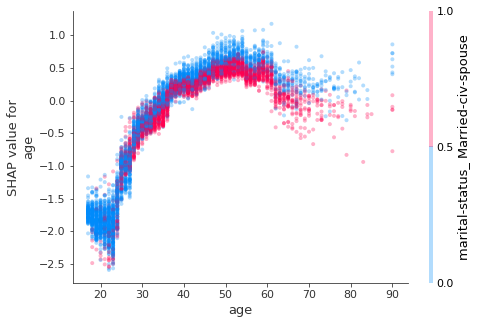

spearman->age: 0.352-val: 0.0000

***************************************************************************
Plot number 2: education_num vs. occupation_ Prof-specialty


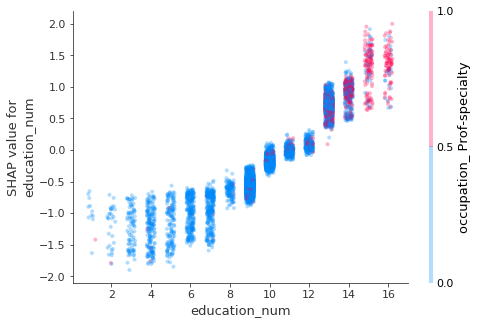

spearman->occupation_ Prof-specialty: 0.417-val: 0.0000


In [43]:
print('Plot number 1: age vs. marital-status_ Married-civ-spouse')
shap.dependence_plot('age',
                     shap_xgb_values_test,df_test,
                     interaction_index='marital-status_ Married-civ-spouse',
                     alpha=0.3)

print('spearman->age: %.3f-val: %.4f' % 
     (spearmanr(df_train['marital-status_ Married-civ-spouse'].values,
               df_train['age'].values)),end='\n\n')

print('*'*75)

print('Plot number 2: education_num vs. occupation_ Prof-specialty')
shap.dependence_plot('education_num',
                     shap_xgb_values_test,df_test,
                     interaction_index='occupation_ Prof-specialty',
                     alpha=0.3, x_jitter=0.4)

print('spearman->occupation_ Prof-specialty: %.3f-val: %.4f' % 
     (spearmanr(df_train['occupation_ Prof-specialty'].values,
               df_train['education_num'].values)))

**Plot number 1: age vs. marital-status_ Married-civ-spouse:**
- As age increase, the probability of marital-status_ Married-civ-spouse also increase<br>
- Spearman correlation is 0.352 and p-val is around 0 which is significant
- As age increases blue data points also increase, this may be due to interaction effect

**Plot number 2: education_num vs. occupation_ Prof-specialty:**<br>
- As education_num increases, the possibility of occupation_ Prof-specialty also increases, quite intuitive
- Spearman correlation is 0.412 and p-val is around 0 which is significant

''

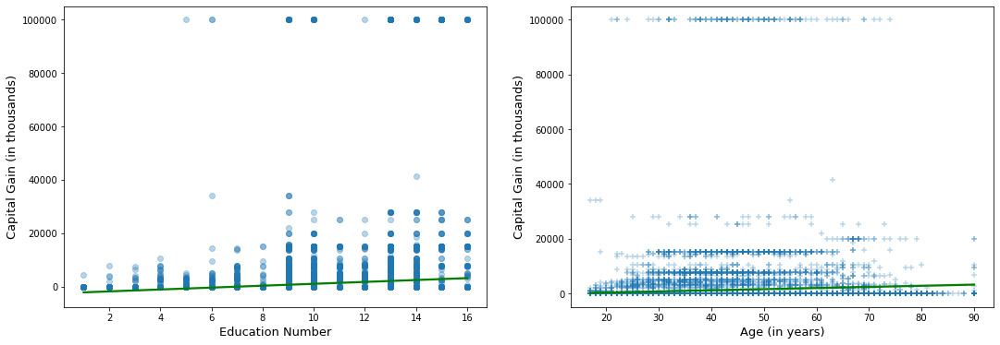

In [37]:
fig, ax = plt.subplots(1,2,figsize=(18,6))
sb.regplot(x=df_train['education_num'], y=df_train['capital_gain'],
          ax=ax[0], scatter_kws={'alpha':0.3}, line_kws={'color':'g'})
ax[0].set_ylabel('Capital Gain (in thousands)', fontsize=13)
ax[0].set_xlabel('Education Number', fontsize=13)

sb.regplot(x=df_train['age'], y=df_train['capital_gain'],
          ax=ax[1], marker='+',
           scatter_kws={'alpha':0.3}, line_kws={'color':'g'})
ax[1].set_ylabel('Capital Gain (in thousands)', fontsize=13)
ax[1].set_xlabel('Age (in years)', fontsize=13)
;

**Observation:**<br>
    - Regplot justifies above observations

In [44]:
from scipy import math

In [46]:
# shap_xgb_explainer.expected_value

-0.0063961484

#### Force plot 1

In [48]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**<br>
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows
- As per XG Boost model the mean effects of all the categories in race is lower on capital_gain
- As per XG Boost model the mean effects of all the categories in race is lower on capital_loss as well

In [50]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**<br>
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows<br>
- As per XG Boost model the mean effect on capital_gain tend to be higher for age interval 29-51 yrs and interval 64-67 yrs and for the rest of the intervals the mean effect fluctuates

In [51]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows
- Here we can see the shap values for various ages, 'age effects' i.e shap values for age vs. 'age'
- As per XG Boost model possibility of having income '>50K' is lower for ages below 36 yrs, after 36 yrs the possibility increases and again decreases after 66 yrs

In [52]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows
- Here we can see the shap values for various education_num, 'education_num effects' i.e shap values for education_num vs. 'education_num'
- As per XG Boost model possibility of having income '>50K' is lower for education_num below 11, after that the possibility increases and it is highest at education_num==15

In [53]:
sample_size = 0.05
sample_test_idx = np.random.choice(a=df_test.shape[0],
                                   size=math.ceil(df_test.shape[0]*sample_size),
                                   replace=False)

shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[sample_test_idx],
                df_test.iloc[sample_test_idx])

**Observation:**
- **Note:** The sample set is selected randomly, for this set of sample the observation is as follows
- Here we can see the shap values for various education_num, 'hours_per_week effects' i.e shap values for hours_per_week vs. 'hours_per_week'
- As per XG Boost model possibility of having income '>50K' is lower for hours_per_week below 40, after that the possibility increases

#### Force plot 2

In [58]:
xgb_pred = xgb.predict(df_test)

In [54]:
# Actual value: 0, Predicted value: 0
shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[0],
                df_test.iloc[0])

**Observation:**<br>
- Actual value: 0, Predicted value: 0
- The output probability of -4.08 is prediction for this observation
- As per XG Boost model the base value is -0.006396 as this is classification and by default the threshold is -0.006396 i.e. anything above -0.006396 is predicted as '1' and anything less than equal to -0.006396 is predicted as '0'
- The features that push prediction **towards '0'** are shown **in 'Red'** and the features that push prediction **away from '0'** are shown **in 'Blue'**
- The value of 'education_ some=college'==1, 'workclass_ Private'==1 and 'fnlwgt'==1.602e+5 influences the model to predict the observation value as '0'
- The values of features in blue have negative impact

In [55]:
# Actual value: 1, Predicted value: 1
shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[5],
                df_test.iloc[5])

**Observation:**<br>
- Actual value: 1, Predicted value: 1
- The output probability of 2.80 is prediction for this observation
- As per the XG Boost model the base value is -0.006396 as this is classification and by default the threshold is -0.006396 i.e. anything above -0.006396 is predicted as '1' and anything less than equal to -0.006396 is predicted as '0'
- The features that push prediction higher **towards '1'** are shown **in 'Red'** and the features that push prediction lower **away from '1'** are shown **in 'Blue'**
- The value of 'education_num'==51, 'hours_per_week'==47, 'occupation_ Prof-speciality'==1, 'marital-status_ Married-civ-spouse'==1 and 'age'==14 influences the model to predict the observation value as '1' and they have positive impact
- The feature 'capital_gain'==0 is in blue and has negative impact

In [70]:
# Actual value: 0, Predicted value: 1
shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[1],
                df_test.iloc[1])

**Observation:**<br>
- Actual value: 0, Predicted value: 1
- The output probability of 0.63 is prediction for this observation
- As per the XG Boost model the base value is -0.006396 as this is classification and by default the threshold is -0.006396 i.e. anything above -0.006396 is predicted as '1' and anything less than equal to -0.006396 is predicted as '0'
- The features that push prediction higher **towards '1'** are shown **in 'Red'** and the features that push prediction lower **away from '1'** are shown **in 'Blue'**
- The value of 'relationship_ Wife'==1 wrongly influences the model to predict the observation value as '1' and model considers them to have positive impact when in fact it increases chances of income being '<=50K'
- The model considers the features in blue to have negative impact especially 'fnlwgt'==5.5057e+4 when infact it increases the chances of income being '>50K'

In [68]:
# Actual value: 1, Predicted value: 0
shap.initjs()
shap.force_plot(shap_xgb_explainer.expected_value,
                shap_xgb_values_test[12],
                df_test.iloc[12])

**Observation:**<br>
- Actual value: 1, Predicted value: 0
- The output probability of -0.19 is prediction for this observation
- As per XG Boost model the base value is -0.006396 as this is classification and by default the threshold is -0.006396 i.e. anything above -0.006396 is predicted as '1' and anything less than equal to -0.006396 is predicted as '0'
- The features that push prediction higher **towards '0'** are shown **in 'Red'** and the features that push prediction lower **away from '0'** are shown **in 'Blue'**
- The value of 'sex_ Female'==0 wrongly influences the model to predict the observation value as '1' and hence model considers them to have positive impact
- The model wrongly considers the features in blue such as 'hours_per_week'==40 as having negative impact when infact it increases the chances of income being '>50K'

**Overall Observation:**
- As 'hours_per_week' increases the chances of income being '>50K' also increases
- 'education_num' of greater than equal to 12 increases the chances of income being '>50K'
- 'age' of greater than equal to 32 increases the chances of income being '>50K'
- Also, 'sex'=='male' increases the chances of income being '>50K'
- 'capital_gain'==0, 'relationship_ Wife'==1 lowers the chances of income being '>50K'
- 'capital_gain' of greater than equal to 4064 increases the chances of income being '>50K'